In [1]:
import scipy, matplotlib
import matplotlib.pyplot as plt
from scipy.fftpack import fft
from scipy.io import wavfile # get the api
import IPython
# from pyAudioAnalysis import audioTrainTest as aT
# import pyAudioAnalysis as aa
from pyAudioAnalysis import ShortTermFeatures as aF
from pyAudioAnalysis import audioBasicIO as aIO 
import numpy as np 
import plotly.graph_objs as go 
import plotly
import IPython

from pyAudioAnalysis import MidTermFeatures as aF
import os
import numpy as np
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
import plotly.graph_objs as go 
import plotly

# Source:
# https://medium.com/behavioral-signals-ai/intro-to-audio-analysis-recognizing-sounds-using-machine-learning-20fd646a0ec5

/Users/anshulmaurya/opt/anaconda3/lib/python3.9/site-packages/pydub/utils.py:170: RuntimeWarning: Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work
  warn("Couldn't find ffmpeg or avconv - defaulting to ffmpeg, but may not work", RuntimeWarning)


In [2]:
IPython.display.display(IPython.display.Audio("./male/SA1.WAV"))
# IPython.display.display(IPython.display.Audio("./Male.wav"))

# Feature Visualizing and Extraction for Male and Female Audio from TIMIT Dataset using PyAudioAnalysis

Analyzing file 1 of 71: male/SA1 2.wav
Analyzing file 2 of 71: male/SA1 3.wav
Analyzing file 3 of 71: male/SA1 4.wav
Analyzing file 4 of 71: male/SA1 5.wav
Analyzing file 5 of 71: male/SA1 6.wav
Analyzing file 6 of 71: male/SA1 7.wav
Analyzing file 7 of 71: male/SA1.wav
Analyzing file 8 of 71: male/SA2 2.wav
Analyzing file 9 of 71: male/SA2 3.wav
Analyzing file 10 of 71: male/SA2 4.wav
Analyzing file 11 of 71: male/SA2 5.wav
Analyzing file 12 of 71: male/SA2 6.wav
Analyzing file 13 of 71: male/SA2 7.wav
Analyzing file 14 of 71: male/SA2.wav
Analyzing file 15 of 71: male/SI1019.wav
Analyzing file 16 of 71: male/SI1045.wav
Analyzing file 17 of 71: male/SI1053.wav
Analyzing file 18 of 71: male/SI1188.wav
Analyzing file 19 of 71: male/SI1437.wav
Analyzing file 20 of 71: male/SI1453.wav
Analyzing file 21 of 71: male/SI1483.wav
Analyzing file 22 of 71: male/SI1524.wav
Analyzing file 23 of 71: male/SI1533.wav
Analyzing file 24 of 71: male/SI1649.wav
Analyzing file 25 of 71: male/SI1675.wav
An

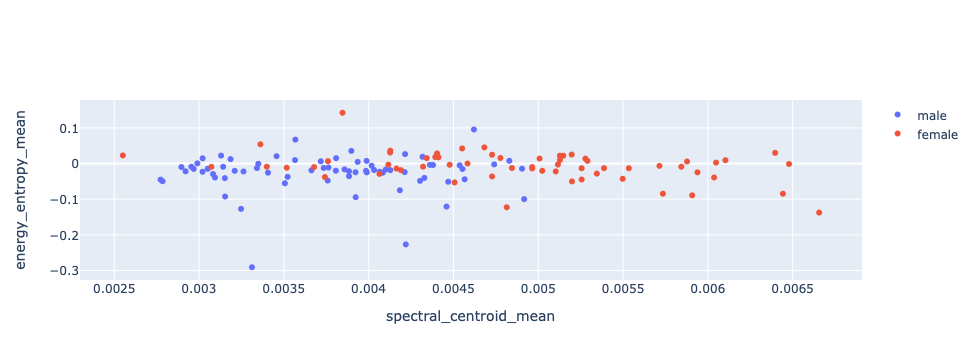

In [3]:
# Example4: plot 2 features for 10 2-second samples 

dirs = ["male", "female"] 
class_names = [os.path.basename(d) for d in dirs] 
m_win, m_step, s_win, s_step = 1, 1, .1, 0.05 
# segment-level feature extraction:
features = [] 
for d in dirs: # get feature matrix for each directory (class) 
    f, files, fn = aF.directory_feature_extraction(d, m_win, m_step, s_win, s_step) 
    features.append(f)
    
# (each element of the features list contains a 
# (samples x segment features) = (10 x 138) feature matrix)
print(features[0].shape, features[1].shape)
    
# select 2 features and create feature matrices for the two classes:
f1 = np.array([features[0][:, fn.index('spectral_flux_mean')],
               features[0][:, fn.index('delta energy_entropy_mean')]])
f2 = np.array([features[1][:, fn.index('spectral_flux_mean')],
               features[1][:, fn.index('delta energy_entropy_mean')]])
# plot 2D features
plots = [go.Scatter(x=f1[0, :],  y=f1[1, :], name=class_names[0], mode='markers'),go.Scatter(x=f2[0, :], y=f2[1, :], 
                    name=class_names[1], mode='markers')]

mylayout = go.Layout(xaxis=dict(title="spectral_centroid_mean"),yaxis=dict(title="energy_entropy_mean"))

plotly.offline.iplot(go.Figure(data=plots, layout=mylayout))

# Using LDA

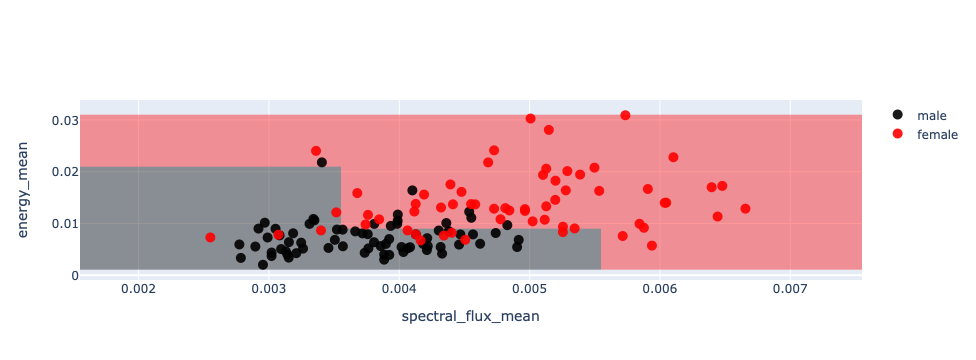

In [4]:
# select 2 features and create feature matrices for the two classes:
f1 = np.array([features[0][:, fn.index('spectral_flux_mean')],
               features[0][:, fn.index('energy_mean')]])
f2 = np.array([features[1][:, fn.index('spectral_flux_mean')],
               features[1][:, fn.index('energy_mean')]])
# plot 2D features
p1 = go.Scatter(x=f1[0, :],  y=f1[1, :], name=class_names[0],
                marker=dict(size=10,color='rgba(0, 0, 0, .9)'),
                mode='markers')
p2 = go.Scatter(x=f2[0, :], y=f2[1, :],  name=class_names[1], 
                marker=dict(size=10,color='rgba(255, 0, 0, .9)'),
                mode='markers')
mylayout = go.Layout(xaxis=dict(title="spectral_centroid_mean"),
                     yaxis=dict(title="energy_entropy_mean"))
y = np.concatenate((np.zeros(f1.shape[1]), np.ones(f2.shape[1]))) 
f = np.concatenate((f1.T, f2.T), axis = 0)

# train the svm classifier
Lcl = LinearDiscriminantAnalysis()
Lcl.fit(f, y) 
# apply the trained model on the points of a grid
x_ = np.arange(f[:, 0].min(), f[:, 0].max(), 0.002) 
y_ = np.arange(f[:, 1].min(), f[:, 1].max(), 0.002) 
xx, yy = np.meshgrid(x_, y_) 
Z = Lcl.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)
# and visualize the grid on the same plot (decision surfaces)
cs = go.Heatmap(x=x_, y=y_, z=Z, showscale=False, 
               colorscale= [[0, 'rgba(0, 0, 0, .4)'], 
                           [1, 'rgba(255, 0, 0, .4)']]) 
mylayout = go.Layout(xaxis=dict(title="spectral_flux_mean"),
                     yaxis=dict(title="energy_mean"))
plotly.offline.iplot(go.Figure(data=[p1, p2, cs], layout=mylayout))

# Using QDA

In [5]:
f1 = np.array([features[0][:, fn.index('spectral_flux_mean')],
               features[0][:, fn.index('spectral_spread_mean')]])

f2 = np.array([features[1][:, fn.index('spectral_flux_mean')],
               features[1][:, fn.index('spectral_spread_mean')]])


# plot 2D features
p1 = go.Scatter(x=f1[0, :],  y=f1[1, :], name=class_names[0],
                marker=dict(size=10,color='rgba(0, 0, 0, .9)'), mode='markers')
p2 = go.Scatter(x=f2[0, :], y=f2[1, :],  name=class_names[1], 
                marker=dict(size=10,color='rgba(255, 0, 0, .9)'), mode='markers')
mylayout = go.Layout(xaxis=dict(title="spectral_centroid_mean"),
                     yaxis=dict(title="energy_entropy_mean"))
y = np.concatenate((np.zeros(f1.shape[1]), np.ones(f2.shape[1]))) 
f = np.concatenate((f1.T, f2.T), axis = 0)

# train the svm classifier
Qcl = QuadraticDiscriminantAnalysis()
Qcl.fit(f, y) 
# apply the trained model on the points of a grid
x_ = np.arange(f[:, 0].min(), f[:, 0].max(), 0.00002)
y_ = np.arange(f[:, 1].min(), f[:, 1].max(), 0.00002)
xx, yy = np.meshgrid(x_, y_) 
Z = Qcl.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape) #/ 2 

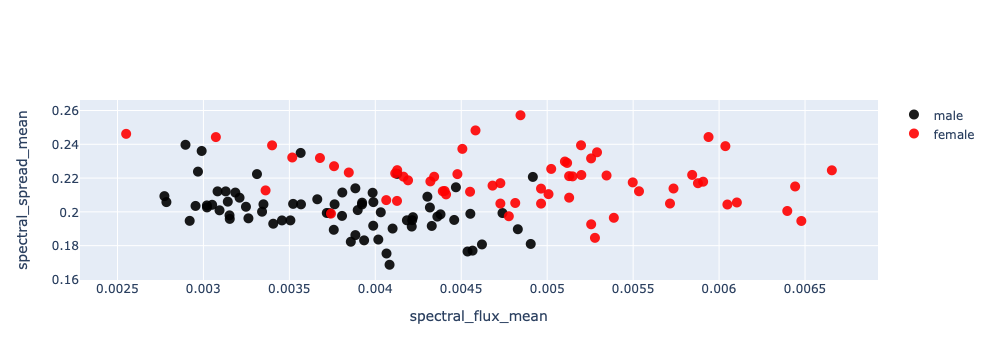

In [6]:
cs = go.Heatmap(x=x_, y=y_, z=Z, showscale=False, 
               colorscale= [[0, 'rgba(0, 0, 0, .5)'], 
                           [1, 'rgba(255, 0, 0, .5)']]) 
mylayout = go.Layout(xaxis=dict(title="spectral_flux_mean"),
                     yaxis=dict(title="spectral_spread_mean"))
plotly.offline.iplot(go.Figure(data=[p1, p2, cs], layout=mylayout))

# Addidng More features for QDA
#### based on above finidings adding extra features makes prediction robust

In [7]:
# select 2 features and create feature matrices for the two classes:
f1 = np.array([features[0][:, fn.index('spectral_flux_mean')],
               features[0][:, fn.index('spectral_spread_mean')],
               features[0][:, fn.index('energy_mean')]])

f2 = np.array([features[1][:, fn.index('spectral_flux_mean')],
               features[1][:, fn.index('spectral_spread_mean')],
               features[1][:, fn.index('energy_mean')]])

# plot 2D features
p1 = go.Scatter(x=f1[0, :],  y=f1[1, :], name=class_names[0], # Male : Based on the directory order
                marker=dict(size=10,color='rgba(0, 0, 0, .9)'),
                mode='markers')
p2 = go.Scatter(x=f2[0, :], y=f2[1, :],  name=class_names[1], # Female : based on the diectory order
                marker=dict(size=10,color='rgba(100, 100, 220, .9)'),
                mode='markers')
mylayout = go.Layout(xaxis=dict(title="spectral_centroid_mean"),
                     yaxis=dict(title="energy_entropy_mean"))
y = np.concatenate((np.zeros(f1.shape[1]), np.ones(f2.shape[1]))) 
f = np.concatenate((f1.T, f2.T), axis = 0)


Q2clf = LinearDiscriminantAnalysis()
Q2clf.fit(f, y) 


LinearDiscriminantAnalysis()

# Prediction on other than TIMIT Data

In [26]:
# IPython.display.display(IPython.display.Audio("./DeepakTestVoice/b4pjs-qzvpl copy 2.wav"))
# IPython.display.display(IPython.display.Audio("./AmitaTestVoice/WhatsApp Ptt 2023-03-27 at 5-Copy1.52.55 PM.wav"))
# IPython.display.display(IPython.display.Audio("./aSamplDeepak/WhatsApp Audio 2023-03-26 at 12-Copy1.32.49 AM.wav"))
# IPython.display.display(IPython.display.Audio("./aSampleAmi/WhatsApp Ptt 2023-03-26 at 12-Copy1.36.09 AM.wav"))
IPython.display.display(IPython.display.Audio("./female2/Female-Copy1.wav"))
IPython.display.display(IPython.display.Audio("./male2/Male-Copy1.wav"))

In [27]:
# from sklearn.metrics import accuracy_score
# accuracy_score(y, Z.flatten)
dirs = ["male2", "female2"]
# dirs = ["DeepakTestVoice", "AmitaTestVoice"]
# dirs = ["aSamplDeepak", "aSampleAmi"]

class_names = [os.path.basename(d) for d in dirs] 
m_win, m_step, s_win, s_step = 1, 1, .1, 0.05 
# segment-level feature extraction:
# fs, s = aIO.read_audio_file("./test/WhatsApp Audio 2023-03-26 at 12.32.49 AM.wav")
# m_win, m_step, s_win, s_step = 1, 1, .1*fs, 0.05*fs 

features = []
#for n in range(f1.shape[0]):
for d in dirs: # get feature matrix for each directory (class) 
    f, files, fn = aF.directory_feature_extraction(d, m_win, m_step, s_win, s_step) 
    features.append(f)

# (each element of the features list contains a 
# (samples x segment features) = (10 x 138) feature matrix)

print(features[0].shape)

# select 2 features and create feature matrices for the two classes:
f12 = np.array([features[0][:, fn.index('spectral_flux_mean')],
                   features[0][:, fn.index('spectral_spread_mean')],#]),
                  features[0][:, fn.index('energy_mean')]])

f22 = np.array([features[1][:, fn.index('spectral_flux_mean')],
                   features[1][:, fn.index('spectral_spread_mean')],#])
                   features[1][:, fn.index('energy_mean')]])

Analyzing file 1 of 3: male2/Male-Copy1.wav
Analyzing file 2 of 3: male2/Male-Copy2.wav
Analyzing file 3 of 3: male2/Male.wav
Feature extraction complexity ratio: 105.9 x realtime
Analyzing file 1 of 3: female2/Female-Copy1.wav
Analyzing file 2 of 3: female2/Female-Copy2.wav
Analyzing file 3 of 3: female2/Female.wav
Feature extraction complexity ratio: 106.2 x realtime
(3, 138)


In [23]:
# features

In [24]:
# fs, s = aIO.read_audio_file("./aSampleAmi/WhatsApp Ptt 2023-03-26 at 12-Copy1.36.09 AM.wav")
# fs

In [30]:
# yhat = cl.predict([[0.003, 0.19]])
yhat = Q2clf.predict(f12)
if sum(yhat) >= 2:
    print("\nFemale Voice\n\n", f12.T)
else:
    print("\nMale Voice\n\n", f12.T)


Male Voice

 [[0.00781297 0.26471972 0.00850477]
 [0.00781297 0.26471972 0.00850477]
 [0.00781297 0.26471972 0.00850477]]


In [31]:
yhat

array([0., 1., 0.])

In [32]:
yhat = Q2clf.predict(f22)
if sum(yhat) >= 2:
    print("\nFemale Voice\n\n", f22.T)
else:
    print("\nMale Voice\n\n", f22.T)


Female Voice

 [[0.00947794 0.22253701 0.01586455]
 [0.00947794 0.22253701 0.01586455]
 [0.00947794 0.22253701 0.01586455]]


In [33]:
yhat

array([0., 1., 1.])

# Extra Info

In [17]:
##    pairing for nice discrimination    ##

# spectral centroid

# spectral flux mean           ** Best Pair **
# spectral_spread_mean

# delta energy_entropy_mean
# spectral flux mean

# delta spectral_centroid_mean
# delta energy_entropy_mean

# Type of Available Features By PyAudioAnalysis

In [18]:
fn

['zcr_mean',
 'energy_mean',
 'energy_entropy_mean',
 'spectral_centroid_mean',
 'spectral_spread_mean',
 'spectral_entropy_mean',
 'spectral_flux_mean',
 'spectral_rolloff_mean',
 'mfcc_1_mean',
 'mfcc_2_mean',
 'mfcc_3_mean',
 'mfcc_4_mean',
 'mfcc_5_mean',
 'mfcc_6_mean',
 'mfcc_7_mean',
 'mfcc_8_mean',
 'mfcc_9_mean',
 'mfcc_10_mean',
 'mfcc_11_mean',
 'mfcc_12_mean',
 'mfcc_13_mean',
 'chroma_1_mean',
 'chroma_2_mean',
 'chroma_3_mean',
 'chroma_4_mean',
 'chroma_5_mean',
 'chroma_6_mean',
 'chroma_7_mean',
 'chroma_8_mean',
 'chroma_9_mean',
 'chroma_10_mean',
 'chroma_11_mean',
 'chroma_12_mean',
 'chroma_std_mean',
 'delta zcr_mean',
 'delta energy_mean',
 'delta energy_entropy_mean',
 'delta spectral_centroid_mean',
 'delta spectral_spread_mean',
 'delta spectral_entropy_mean',
 'delta spectral_flux_mean',
 'delta spectral_rolloff_mean',
 'delta mfcc_1_mean',
 'delta mfcc_2_mean',
 'delta mfcc_3_mean',
 'delta mfcc_4_mean',
 'delta mfcc_5_mean',
 'delta mfcc_6_mean',
 'delta m

In [20]:
len(fn)

138

In [19]:
# # code for down sampling

# def downsampleWav(src, dst, inrate=48000, outrate=16000, inchannels=2, outchannels=1):
#     import wave
#     import audioop
    
#     if not os.path.exists(src):
#         print ('Source not found!')
#         return False

#     if not os.path.exists(os.path.dirname(dst)):
#         os.makedirs(os.path.dirname(dst))

#     try:
#         s_read = wave.open(src, 'r')
#         s_write = wave.open(dst, 'w')
#     except:
#         print ('Failed to open files!')
#         return False

#     n_frames = s_read.getnframes()
#     data = s_read.readframes(n_frames)

#     try:
#         converted = audioop.ratecv(data, 2, inchannels, inrate, outrate, None)
#         if outchannels == 1:
#             converted = audioop.tomono(converted[0], 2, 1, 0)
#     except:
#         print ('Failed to downsample wav')
#         return False

#     try:
#         s_write.setparams((outchannels, 2, outrate, 0, 'NONE', 'Uncompressed'))
#         s_write.writeframes(converted)
#     except:
#         print ('Failed to write wav')
#         return False

#     try:
#         s_read.close()
#         s_write.close()
#     except:
#         print ('Failed to close wav files')
#         return False

#     return True

# src = "AmitaTestVoice/WhatsApp Ptt 2023-03-27 at 5-Copy1.52.55 PM.wav"
# dst = "./WhatsApp Ptt 2023-03-26 at 12-Copy1.36.09 AM.wav"
# downsampleWav(src, dst)